# Загрузка библиотек

**umap** установить в отдельное виртуальное окружение анаконды для избежания ошибок

In [2]:
# !pip install python-youtube
# !pip install pyyaml
# !pip install wordcloud
# !pip install --upgrade gensim
# !pip install nltk
# !pip install pymorphy2
# !pip install plotly
# !conda install -c conda-forge umap-learn
# !pip install yellowbrick
# !pip install hdbscan
# !pip install stop-words
# !pip install top2vec
# !pip install pymystem3

In [ ]:
from collections import Counter
import re
import string
from typing import Optional, Union, List

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import yaml

import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords

import pymorphy2
from pymystem3 import Mystem
from stop_words import get_stop_words

from top2vec import Top2Vec
from gensim.models.doc2vec import Doc2Vec, TaggedDocument
from gensim.models import Word2Vec, FastText

from sklearn.cluster import DBSCAN, AgglomerativeClustering, SpectralClustering, KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.decomposition import TruncatedSVD, PCA
from sklearn.pipeline import make_pipeline
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer

from hdbscan import HDBSCAN
from yellowbrick.utils import KneeLocator
from wordcloud import WordCloud
import umap

from importlib import reload

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Rodion\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# 1 Yotube API

- [How to Extract YouTube Data using YouTube API in Python](https://www.thepythoncode.com/article/using-youtube-api-in-python)
- [pyyoutube](https://pypi.org/project/python-youtube/)
- [medium: YouTube Data API v3 in Python: Tutorial with examples](https://medium.com/mcd-unison/youtube-data-api-v3-in-python-tutorial-with-examples-e829a25d2ebd#d5cc)
- [YouTube: Data api. CommentThreads](https://developers.google.com/youtube/v3/docs/commentThreads/list?apix_params=%7B%22part%22%3A%5B%22replies%22%5D%7D)
- [miracl1e6: auto-pipeline-airflow-mlflow ](https://github.com/miracl1e6/auto-pipeline-airflow-mlflow/blob/master/notebooks/Topic%20modeling.ipynb)

In [ ]:
# конфигурационные параметры
RS = 7

with open('config.yaml', 'r') as f:
    config = yaml.safe_load(f)

Комментарии парсяться только основные, ответы на комментарии не берутся

In [3]:
from helper.youtube_parser import YouTubeApi

In [4]:
%%time
url = 'https://youtu.be/RcBGYODF5Ks'

youtube = YouTubeApi(config.get('youtube-api-key'))
corpus_comments = youtube.get_comments(url, max_comments=100, n_videos=30)
print('Количество комментариев:', len(corpus_comments))

Количество комментариев: 3100
CPU times: total: 13.9 s
Wall time: 36.7 s


In [5]:
corpus_comments[:3]

['Привет Друзья!! А вот и новая таблетка перед сном! Ждали?)<br><br>Кое-что из внутренностей:\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=01m15s">01:15</a> Венера\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=09m50s">09:50</a> Марс\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=18m40s">18:40</a> Пояс Астероидов\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=28m40s">28:40</a> Церера\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=38m40s">38:40</a> Юпитер\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=47m50s">47:50</a> Сатурн\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=55m55s">55:55</a> Уран\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=1h05m10s">1:05:10</a> Нептун\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=1h14m13s">1:14:13</a> Плутон\r<br><a href="https://www.youtube.com/watch?v=RcBGYODF5Ks&amp;t=1h24m07s">1:24:07</a>  Пояс 

# 2 Предобработка текста

>*Мусор на входе - мусор на выходе*

Сырые комментарии не пригодны для качественного моделирования. Очистим данные испоьзуя техники NLP

- [stackoverflow: removing emojis from a string in Python](https://stackoverflow.com/questions/33404752/removing-emojis-from-a-string-in-python)
- [kaggle: Getting started with Text Preprocessing](https://www.kaggle.com/code/sudalairajkumar/getting-started-with-text-preprocessing#Removal-of-Emojis)


+ [Википедия: Специальные символы](https://ru.wikipedia.org/wiki/%D0%92%D0%B8%D0%BA%D0%B8%D0%BF%D0%B5%D0%B4%D0%B8%D1%8F:%D0%A1%D0%BF%D0%B5%D1%86%D0%B8%D0%B0%D0%BB%D1%8C%D0%BD%D1%8B%D0%B5_%D1%81%D0%B8%D0%BC%D0%B2%D0%BE%D0%BB%D1%8B)
+ [Таблица символов Юникода](https://unicode-table.com/ru/)

In [6]:
# фильтры
min_symbols = 2
min_words = 3

# лемматизатор pymystem3
mystem = Mystem()

# загружаем стоп слова
stop_words1 = set(get_stop_words('ru'))
stop_words2 = set(stopwords.words('russian'))
stop_words3 = set(stopwords.words('english'))
russian_stopwords = stop_words1.union(stop_words2).union(stop_words3)
list(russian_stopwords)[:5]

['t', 'которая', 'него', 'own', 'шестнадцатый']

In [7]:
from helper.preprocessor import get_clean_text

In [8]:
%%time
filtered_tokenized_text = get_clean_text(corpus_comments, 
                                         stem=mystem, 
                                         stopwords=russian_stopwords, 
                                         min_symbols=min_symbols, 
                                         min_words=min_words)
print('Количество очищенных комментариев:', len(filtered_tokenized_text))

Количество очищенных комментариев: 2784
CPU times: total: 1.23 s
Wall time: 9.29 s


In [9]:
count = Counter(sum(filtered_tokenized_text, []))
print('Количество токенов:', len(count))

Количество токенов: 5499


In [10]:
# палитры для plotly графиков
px.colors.named_colorscales()[:5]

['aggrnyl', 'agsunset', 'blackbody', 'bluered', 'blues']

In [11]:
df_count = pd.DataFrame(count.most_common(50), columns=['Токен', 'Частота']).reset_index()
fig = px.bar(df_count.sort_values('Частота'), 
             y='Токен', 
             x='Частота', 
             color='index', 
             color_continuous_scale='jet_r', 
             hover_name='Токен',
             hover_data={'Токен': False, 'index': False}, 
             )
fig.update_layout(title_text='Топ 50 частых токенов', title_x=0.5, height=900)
fig.update_coloraxes(showscale=False)

In [12]:
import helper.outlier
reload(helper.outlier)
from helper.outlier import remove_all_outlier_IQR, remove_outlier_sigma

In [13]:
df_tokens = pd.DataFrame({'tokens': filtered_tokenized_text})
df_tokens['len'] = df_tokens['tokens'].apply(len)

df_without_outlir_tokens = remove_all_outlier_IQR(df_tokens, 'len')

Итераций удаления выбросов: 3


In [14]:
df_tokens['len'].min()

3

In [15]:
fig = px.histogram(df_tokens, x="len",
                   marginal="box", 
                   title='Распределение комменатриев по длине')
fig.update_layout(xaxis_title='Длина комментария (количество токенов)',
                  yaxis_title='Количестов комментариев')
# fig.update_xaxes(type='category')
fig.show()

In [16]:
fig = px.histogram(df_without_outlir_tokens, x="len",
                   marginal="box",
                   title='Распределение комменатриев по длине с очисткой по IQR')
fig.update_layout(xaxis_title='Длина комментария (количество токенов)',
                  yaxis_title='Количестов комментариев')
# fig.update_xaxes(type='category')
fig.show()

In [17]:
df_tokens_3_sigma = remove_outlier_sigma(df_tokens, 'len')

fig = px.histogram(df_tokens_3_sigma.sort_values('len'), x="len",
                   marginal="box",
                   title='Распределение комменатриев по длине с очисткой по 3 sigma')
fig.update_layout(xaxis_title='Длина комментария (количество токенов)',
                  yaxis_title='Количестов комментариев')
fig.update_xaxes(type='category')
fig.show()

# 3 Векторизация текста

Перевод с языка человека на язык машин

+ Классические методы
  - CountVectorizer
  - TfidfVectorizer
+ Эмбединги слов/предложений/документов
  - word2vec
  - Glove
  - fasttext
  - doc2vec
  - top2vec
+ Глубокие нейронные сети  
  - ELMO
  - BERT
  
+ *LDA  

## 3.1 CountVectorizer

Каждый элемент вектора документа - это количество вхождений определенного слова в документе

+ Теряется информация о порядке слов
+ Модель не пытается узнать значение лежащее в основе слова

In [18]:
text_corpus = [' '.join(list_token) for list_token in filtered_tokenized_text]

In [19]:
cnt_vctrz = CountVectorizer(max_df=0.7, min_df=5)
X_cnt = cnt_vctrz.fit_transform(text_corpus)
X_cnt.shape

(2784, 999)

## 3.2 TfidfVectorizer

In [20]:
tfidf_vctrz = TfidfVectorizer(max_df=0.7, min_df=5)
X_tfidf = tfidf_vctrz.fit_transform(text_corpus)
X_tfidf.shape

(2784, 999)

## 3.3 Word2Vec

Слова представляются в виде вектора, где векторы, расположенные близко друг к другу в векторном пространстве, имеют схожие значения в зависимости от контекста

+ [gensim: Word2Vec](https://radimrehurek.com/gensim/models/word2vec.html?highlight=word2vec#module-gensim.models.word2vec)
+ [How to Cluster Documents Using Word2Vec and K-means](https://dylancastillo.co/nlp-snippets-cluster-documents-using-word2vec/)
+ [kaggle: Gensim Word2Vec Tutorial](https://www.kaggle.com/code/pierremegret/gensim-word2vec-tutorial/notebook)

In [21]:
w2v_model = Word2Vec(min_count=5,
                     window=5,
                     vector_size=100,
                     negative=10,
                     seed=0,
                     )

w2v_model.build_vocab(filtered_tokenized_text, update=False)
w2v_model.train(filtered_tokenized_text, 
                total_examples=w2v_model.corpus_count, 
                epochs=40)
w2v_model.wv.vectors.shape

(1042, 100)

In [22]:
w2v_model.wv.most_similar("большой", topn=10)

[('вкладывать', 0.8416173458099365),
 ('увлекательно', 0.8275448083877563),
 ('браво', 0.8248520493507385),
 ('колоссальный', 0.8224595785140991),
 ('мега', 0.8106991052627563),
 ('чудесный', 0.8000674843788147),
 ('восхищать', 0.788954496383667),
 ('завораживающе', 0.7855713367462158),
 ('дорогой', 0.7828655242919922),
 ('поблагодарить', 0.781773567199707)]

In [23]:
from helper.embedder import text_embeddings

In [24]:
X_w2v = text_embeddings(tokenized_corpus=filtered_tokenized_text, model=w2v_model)
X_w2v.shape

(2784, 100)

## 3.4 FastText

+ [gensim: FastText](https://radimrehurek.com/gensim/models/fasttext.html)

Преимуществa
+ Позволяет получать векторы слов,которых не было в словаре
+ Решает проблему опечаток

In [25]:
ft_model = FastText(min_count=5,
                    window=5,
                    vector_size=100,
                    negative=10,
                    seed=RS,
                    )

ft_model.build_vocab(filtered_tokenized_text, update=False)
ft_model.train(filtered_tokenized_text, 
               total_examples=ft_model.corpus_count, 
               epochs=40)
ft_model.wv.vectors.shape

(1042, 100)

In [26]:
"душа" in ft_model.wv.index_to_key

True

In [27]:
ft_model.wv.most_similar("душа", topn=10)

[('намного', 0.9191911816596985),
 ('правда', 0.8915718197822571),
 ('youtube', 0.8876858949661255),
 ('наверное', 0.8681844472885132),
 ('многий', 0.8615050315856934),
 ('вау', 0.8507499098777771),
 ('насчет', 0.8492001295089722),
 ('семья', 0.8402511477470398),
 ('случайно', 0.837936520576477),
 ('кожа', 0.8376619815826416)]

In [28]:
# токены которых нет в модели
diff = set(count.keys()).difference(set(ft_model.wv.index_to_key))
print(len(diff))

len(diff) + ft_model.wv.vectors.shape[0] == len(count.keys())

4457


True

In [29]:
X_ft = text_embeddings(tokenized_corpus=filtered_tokenized_text, model=ft_model)
X_ft.shape

(2784, 100)

## 3.5 Doc2Vec

[gensim: Doc2Vec](https://radimrehurek.com/gensim/models/doc2vec.html)

+ Векторы, сгенерированные doc2vec, можно использовать для поиска сходства между предложениями/абзацами/документами
+ С помощью doc2vec можно получить вектор для предложения без дополнительных вычислений, как в word2vec

`Doc2Vec.infer_vector(list[str])` - выводит вектор документа для заданной последовательности слов

In [30]:
documents = [TaggedDocument(doc, [i]) for i, doc in enumerate(filtered_tokenized_text)]

In [31]:
d2v_model = Doc2Vec(vector_size=100, window=5, min_count=5, workers=-1)
d2v_model.build_vocab(documents)
d2v_model.train(documents, 
                total_examples=d2v_model.corpus_count, 
                epochs=40)

In [32]:
print('Количество документов:', len(documents))
print('Размерность матрицы слов:', d2v_model.wv.vectors.shape)
print('Размерность матрицы документов:', d2v_model.dv.vectors.shape)

Количество документов: 2784
Размерность матрицы слов: (1042, 100)
Размерность матрицы документов: (2784, 100)


In [33]:
# проверяем похожесть документа на самого себя
doc_id = 1
inferred_vector = d2v_model.infer_vector(documents[doc_id].words)
sim = d2v_model.dv.most_similar([inferred_vector], topn=len(d2v_model.dv))
sim[:5]

[(2422, 0.3103942573070526),
 (238, 0.3063911199569702),
 (48, 0.2981356084346771),
 (2487, 0.2956744134426117),
 (294, 0.2940818965435028)]

In [34]:
rank = list(map(lambda x: x[0], sim)).index(doc_id)
print('Позиция в топ похожести:', rank)

Позиция в топ похожести: 1540


In [35]:
X_d2v = d2v_model.dv.vectors

## Top2Vec

[doc: Top2Vec](https://top2vec.readthedocs.io/en/latest/Top2Vec.html)

+ Не требует списков стоп-слов, стемминга или лемматизации

In [113]:
model_t2v = Top2Vec(text_corpus, 
                    speed='learn', 
                    min_count=5, 
#                     embedding_model='universal-sentence-encoder-multilingual-large'
                   )

2022-10-06 16:15:11,861 - top2vec - INFO - Pre-processing documents for training
2022-10-06 16:15:12,183 - top2vec - INFO - Creating joint document/word embedding
2022-10-06 16:15:17,149 - top2vec - INFO - Creating lower dimension embedding of documents
2022-10-06 16:15:39,478 - top2vec - INFO - Finding dense areas of documents
2022-10-06 16:15:39,787 - top2vec - INFO - Finding topics


In [114]:
model_t2v.get_num_topics()

2

In [115]:
topic_sizes, topic_nums = model_t2v.get_topic_sizes()
print(topic_sizes)
print(topic_nums)

[709 351]
[0 1]


In [116]:
topic_words, word_scores, topic_nums = model_t2v.get_topics()

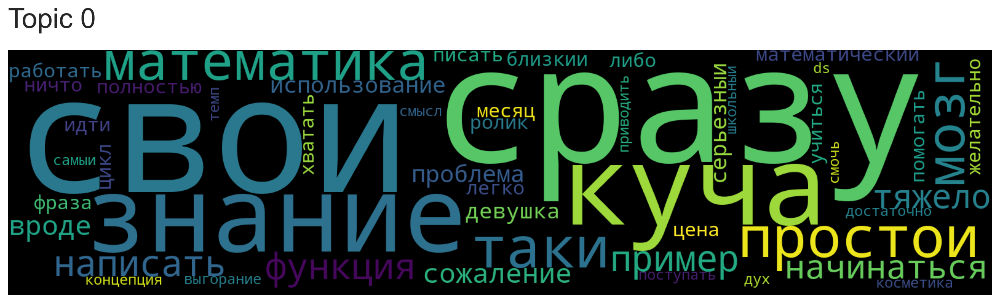

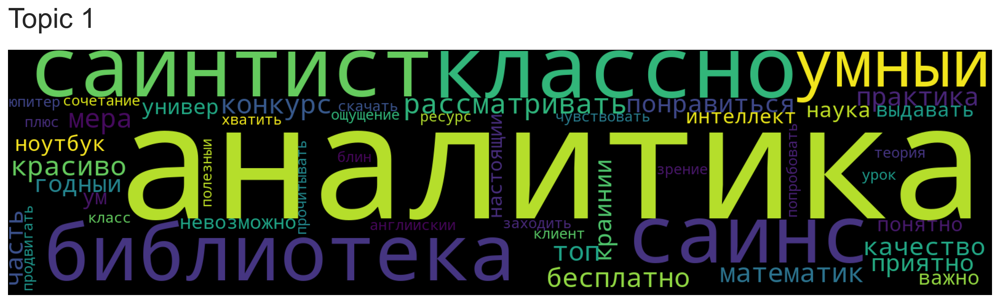

In [117]:
topic_words, word_scores, topic_scores, topic_nums = model_t2v.search_topics(keywords=["ds"], 
                                                                             num_topics=len(topic_nums))
for topic in topic_nums:
    model_t2v.generate_topic_wordcloud(topic)

# 4 Понижение размерности

Уменьшение количества признаков данных с сохранением эффективности и точности решения задачи
+ Позволяет сэкономить время и вычислительные затраты
+ Повышает интерпритируемость

Алгоритмы:
+ Линейные
  + [PCA](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html?highlight=pca#sklearn.decomposition.PCA)
  + [TruncatedSVD](https://scikit-learn.org/stable/modules/generated/sklearn.decomposition.TruncatedSVD.html#sklearn.decomposition.TruncatedSVD)
+ Нелинейные
  + [T-SNE](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html?highlight=tsne#sklearn.manifold.TSNE)
  + [UMAP](https://umap-learn.readthedocs.io/en/latest/index.html)

Инсайты:
- Перед понижением размерности (PCA, T-SNE, UMAP) полезно привести величины к одному масштабу (StandardScaler)
- PCA используется для плотных данных, TruncatedSVD для разряженных данных  
- После TruncatedSVD использовать Normalizer
  + [scikit-learn: Clustering text documents using k-means](https://scikit-learn.org/stable/auto_examples/text/plot_document_clustering.html#sphx-glr-auto-examples-text-plot-document-clustering-py)
- Перед TSNE уменьшить размерность хотя бы до 50 другим методом (PCA, TruncatedSVD)  


## 4.1 PCA

**Principal component analysis (PCA)** - разложения многомерного набора данных на набор последовательных ортогональных компонентов, которые объясняют максимальную величину дисперсии.

>*Если 0 < n_components < 1 и svd_solver == 'full', выбирается такое количество компонентов, чтобы величина дисперсии, которую необходимо объяснить, превышала процент, указанный n_components.*

С стандартизацией

In [36]:
from helper.plots import multiplot_explained_ratio

In [37]:
X_cnt_std = StandardScaler().fit_transform(X_cnt.toarray())
X_tfidf_std = StandardScaler().fit_transform(X_tfidf.toarray())
X_w2v_std = StandardScaler().fit_transform(X_w2v)
X_ft_std = StandardScaler().fit_transform(X_ft)
X_d2v_std = StandardScaler().fit_transform(X_d2v)

embeddings = [X_cnt_std, X_tfidf_std, X_w2v_std, X_ft_std, X_d2v_std]
title = ['CountVectorizer', 'TfidfVectorizer', 'Word2Vec', 'FastText', 'Doc2Vec']

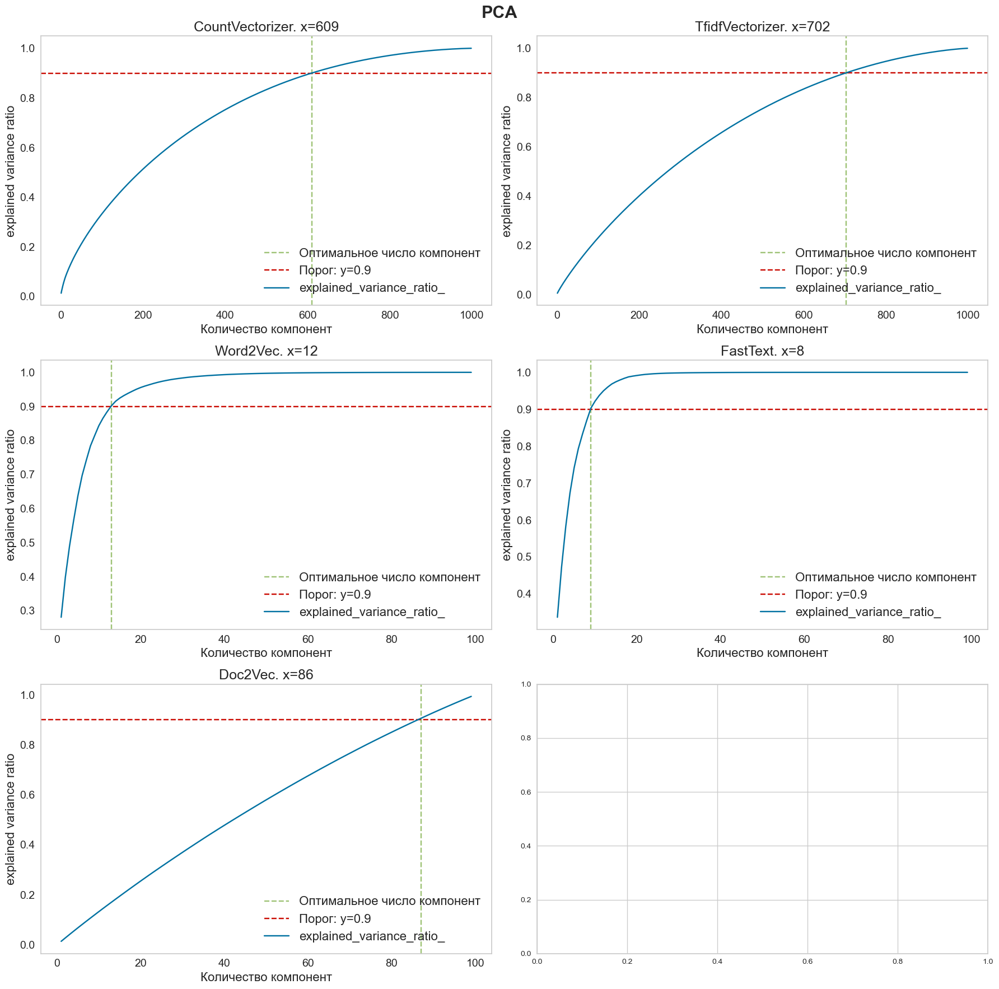

In [38]:
pca = PCA(random_state=RS)
multiplot_explained_ratio(pca, embeddings, title, treshold=.9)

## 4.2 TruncatedSVD

**TruncatedSVD** - усеченное разложение по сингулярным значениям (SVD)

+ Использование **TruncatedSVD** на *count/tf-idf* векторах называется **latent semantic analysis (LSA)** 
+ Для **LSA**, рекомендуется размерность 100

Без стандартизации

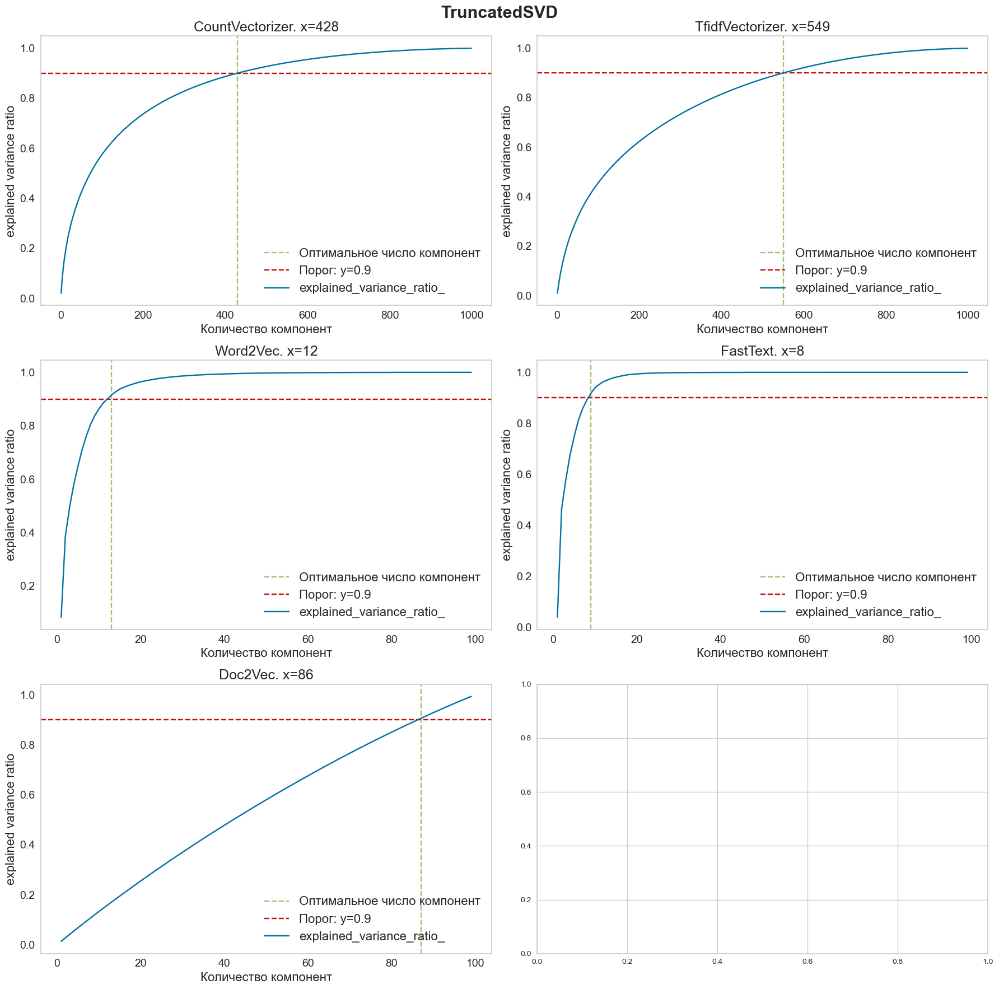

In [39]:
svd = TruncatedSVD(random_state=RS)
embeddings = [X_cnt, X_tfidf, X_w2v, X_ft, X_d2v]
multiplot_explained_ratio(svd, embeddings, title)   

## 4.3 TSNE

**t-distributed Stochastic Neighbor Embedding (t-SNE)** - инструмент для визуализации многомерных данных

+ Требует больших вычислительных ресурсов
+ Чувствителел к локальной структуре

[medium: Алгоритм машинного обучения t-SNE — отличный инструмент для снижения размерности в Python](https://medium.com/nuances-of-programming/%D0%B0%D0%BB%D0%B3%D0%BE%D1%80%D0%B8%D1%82%D0%BC-%D0%BC%D0%B0%D1%88%D0%B8%D0%BD%D0%BD%D0%BE%D0%B3%D0%BE-%D0%BE%D0%B1%D1%83%D1%87%D0%B5%D0%BD%D0%B8%D1%8F-t-sne-%D0%BE%D1%82%D0%BB%D0%B8%D1%87%D0%BD%D1%8B%D0%B9-%D0%B8%D0%BD%D1%81%D1%82%D1%80%D1%83%D0%BC%D0%B5%D0%BD%D1%82-%D0%B4%D0%BB%D1%8F-%D1%81%D0%BD%D0%B8%D0%B6%D0%B5%D0%BD%D0%B8%D1%8F-%D1%80%D0%B0%D0%B7%D0%BC%D0%B5%D1%80%D0%BD%D0%BE%D1%81%D1%82%D0%B8-%D0%B2-python-f87af7eac9fe)

[plotly scatter_3d](https://plotly.com/python-api-reference/generated/plotly.express.scatter_3d.html)

In [40]:
pipe_ft = make_pipeline(StandardScaler(), 
                        PCA(n_components=0.9),
                        TSNE(n_components=3,
                             random_state=RS,
                             )
                        )
X_ft_tsne = pipe_ft.fit_transform(X_ft)

C:\Programs\Anaconda\anaconda3\envs\env-umap-test\lib\site-packages\sklearn\manifold\_t_sne.py:795: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

C:\Programs\Anaconda\anaconda3\envs\env-umap-test\lib\site-packages\sklearn\manifold\_t_sne.py:805: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



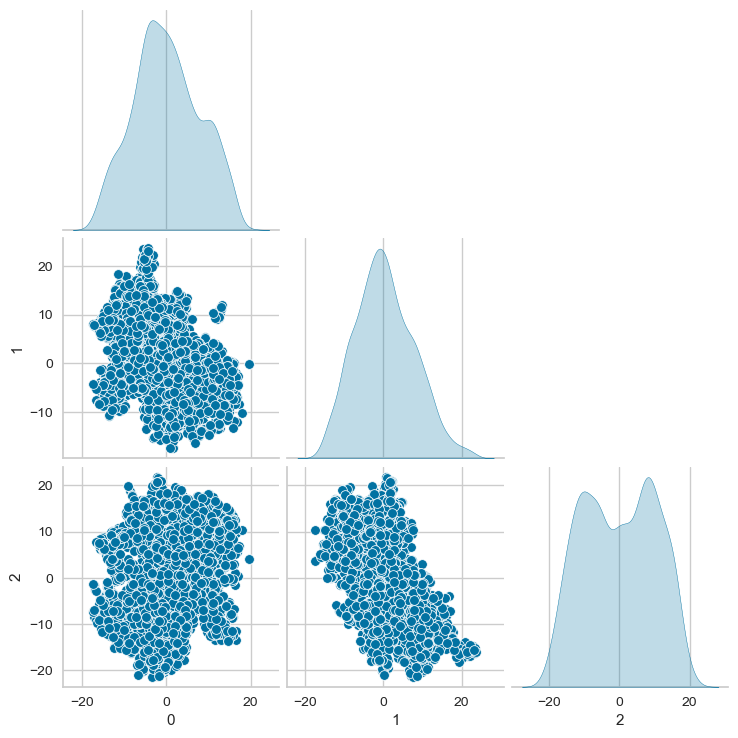

In [41]:
sns.pairplot(data=pd.DataFrame(X_ft_tsne), corner=True, diag_kind="kde")

## 4.4 UMAP

**Uniform Manifold Approximation and Projection (UMAP)** - это метод уменьшения размерности, который можно использовать для визуализации аналогично t-SNE, а также для общего нелинейного уменьшения размерности.

Преимущества:
+ Быстро работает на больших данных
+ Хорошо сочетается с HDBSCAN кластеризацией
+ Лучше сохраняет некоторые аспекты глобальной структуры данных, чем T-SNE
+ Поддерживает неметрические функции расстояния (cosine distance)

[doc: Using UMAP for Clustering](https://umap-learn.readthedocs.io/en/latest/clustering.html)

In [40]:
embeddings = [X_cnt.toarray(), X_tfidf.toarray(), X_w2v, X_ft, X_d2v]
title = ['CountVectorizer', 'TfidfVectorizer', 'Word2Vec', 'FastText', 'Doc2Vec']

X = {t: {'embedding': e} for t, e in zip(title, embeddings)}

In [41]:
for vectorizer in X.keys():
    pipe_umap = make_pipeline(StandardScaler(), 
                              umap.UMAP(n_components=3, 
                                        metric='cosine',
                                        random_state=RS,
                                        n_neighbors=15,
                                       )
                             )
    X[vectorizer]['umap'] = pipe_umap.fit_transform(X[vectorizer]['embedding'])

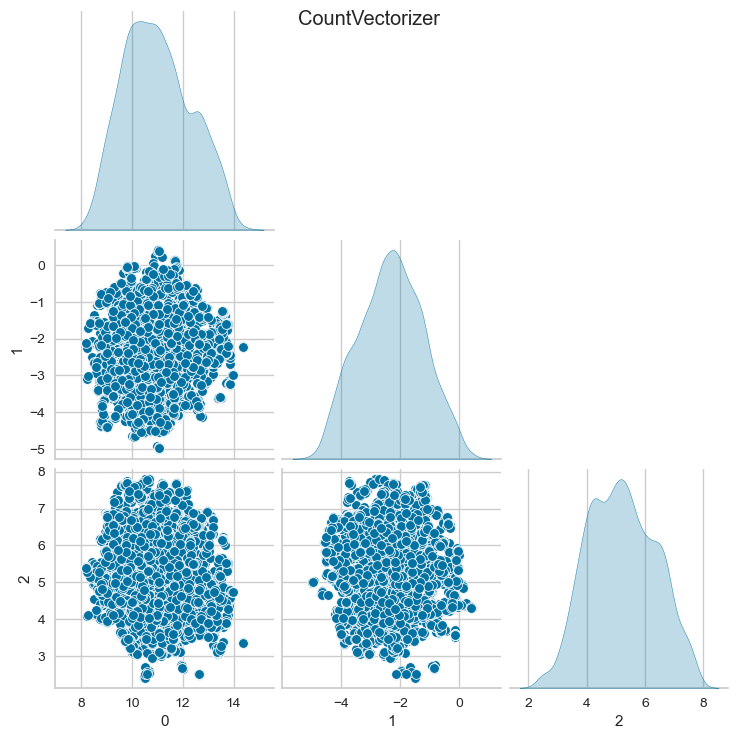

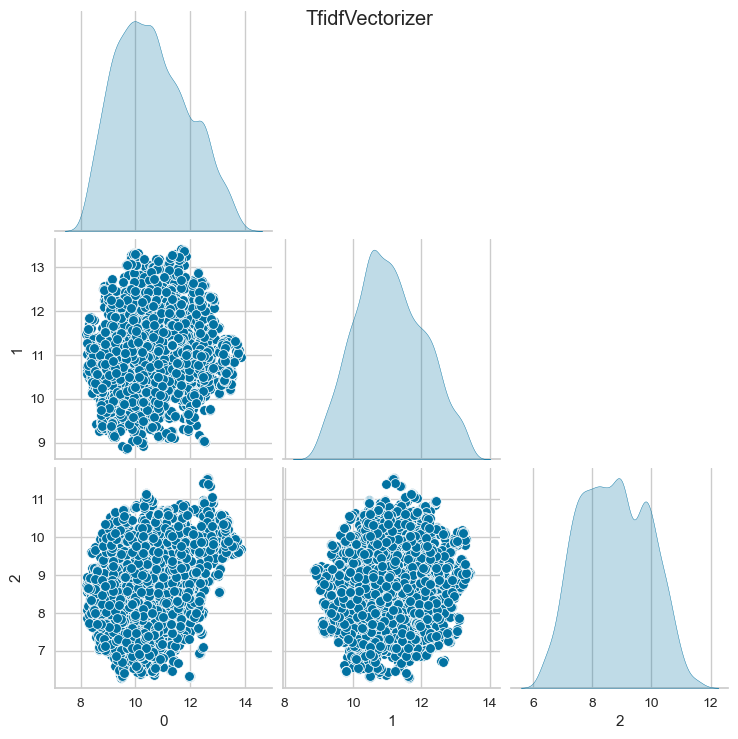

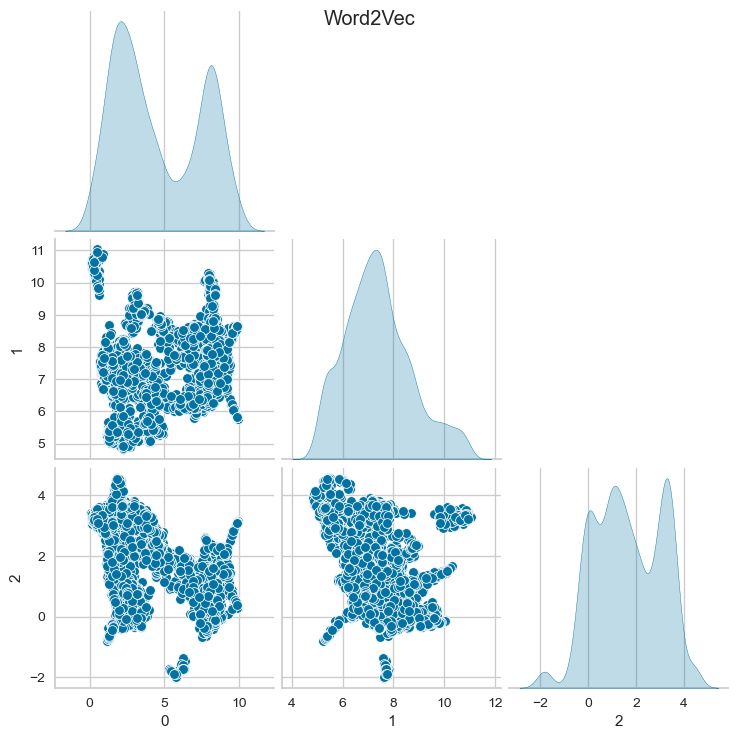

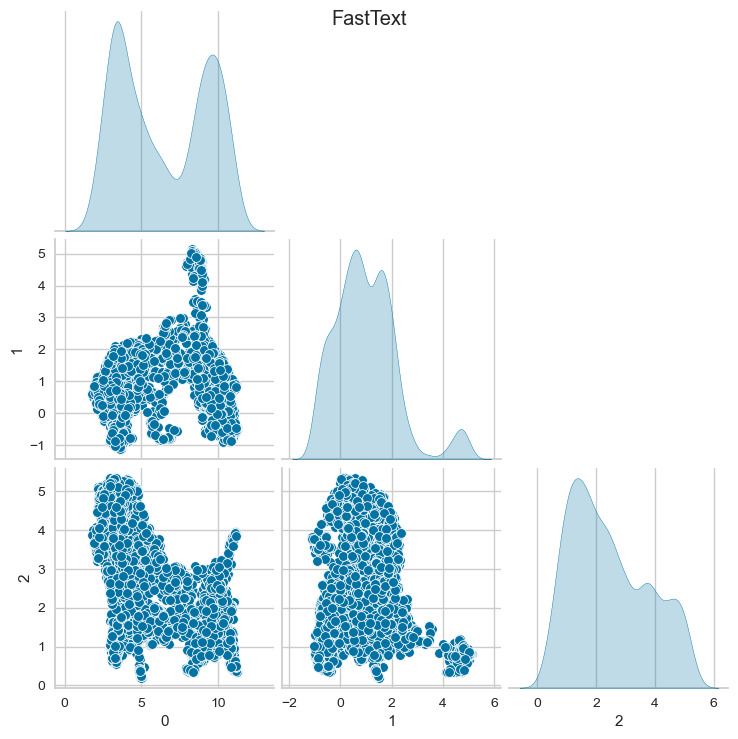

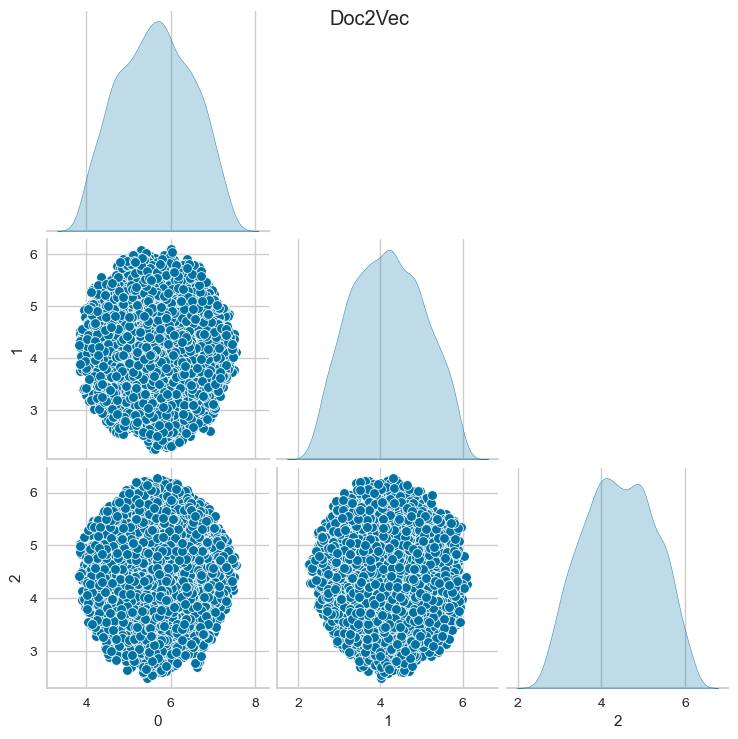

In [42]:
for vectorizer in X.keys():
    g = sns.pairplot(data=pd.DataFrame(X[vectorizer]['umap']), corner=True, diag_kind="kde")
    g.fig.suptitle(vectorizer)

Инсайт: Наиболее интересные (не симметричные, разрозненные) распределения получились у Word2Vec и FastText

In [43]:
X_ft_umap = X['FastText']['umap']

In [44]:
# тип данных приводим к менее точному для сокращения используемой памяти, 
# на основании того что эти данные будут дальше использовать только для визуализации
df_clusters = pd.DataFrame()
df_clusters[['x', 'y', 'z']] = X_ft_umap.astype(np.float16)

In [45]:
from helper.plots import plot_3d

In [46]:
plot_3d(df_clusters)

# 5 Кластеризация
Алгоритмы кластеризации:  
+ [KMeans](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.KMeans.html#sklearn.cluster.KMeans)
+ [SpectralClustering](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.SpectralClustering.html#sklearn.cluster.SpectralClustering)
+ [AgglomerativeClustering](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.AgglomerativeClustering.html#sklearn.cluster.AgglomerativeClustering)
+ [DBSCAN](https://scikit-learn.org/stable/modules/generated/sklearn.cluster.DBSCAN.html#sklearn.cluster.DBSCAN)
+ [HDBSCAN](https://hdbscan.readthedocs.io/en/latest/index.html)

Полезные источники:
+ [habr: Кластерный анализ корпуса текстов](https://habr.com/ru/post/590983/?ysclid=l8edol7i5o291860838)
+ [habr: Открытый курс машинного обучения. Тема 7. Обучение без учителя: PCA и кластеризация](https://habr.com/ru/company/ods/blog/325654/)
+ [kaggle: Text Clustering](https://www.kaggle.com/code/karthik3890/text-clustering)
+ [towardsdatascience: A Friendly Introduction to Text Clustering](https://towardsdatascience.com/a-friendly-introduction-to-text-clustering-fa996bcefd04)
+ [medium: News documents clustering using python (latent semantic analysis)](https://medium.com/kuzok/news-documents-clustering-using-python-latent-semantic-analysis-b95c7b68861c)
+ [towardsdatascience: Clustering sentence embeddings to identify intents in short text](https://towardsdatascience.com/clustering-sentence-embeddings-to-identify-intents-in-short-text-48d22d3bf02e)

+ [miracl1e6: clustering](https://nbviewer.org/github/miracl1e6/clustering/blob/master/Clustering_analysis.ipynb)
+ [kaggle: Text Clustering (TFIDF, PCA...) Beginner Tutorial](https://www.kaggle.com/code/albeffe/text-clustering-tfidf-pca-beginner-tutorial)
+ [kaggle: Customer Segmentation: Clustering](https://www.kaggle.com/code/karnikakapoor/customer-segmentation-clustering)

Некоторые замечания:
+ Для решения задачи выявления смысловых интентов в данных необязательно кластеризовать все примеры выборки. Задача состоит в выделение как можно релевантных, репрезентативных объектов для каждого кластера
+ Лучшим вариантом был бы алгоритм сам определяющий количество кластеров


## 5.1 Метрики качества кластеризации



Метрики не требующие истинных меток кластеров:
+ **(метод локтя для kmeans)**
+ **Коэффициент силуэта**
  + Лучшее значение равно 1, а худшее значение равно -1. Значения около 0 указывают на перекрывающиеся кластеры.
+ **Calinski-Harabasz Index**
  + Чем выше - тем лучшее кластеры разделились
  + Выше для выпуклых кластеров, нежели чем для кластеров основанных на плотности
+ **Davies-Bouldin Index**
  + Минимальное значение 0 
  + Чем ниже - тем лучше кластеры разделились
  + Выше для выпуклых кластеров, нежели чем для кластеров основанных на плотности 

+ [scikit-learn: Selecting the number of clusters with silhouette analysis on KMeans clustering](https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py)
+ [Учебник по ML от ШАД кластеризация](https://ml-handbook.ru/chapters/clustering/intro)
+ [doc: Yellowbrick: Machine Learning Visualization](https://www.scikit-yb.org/en/latest/index.html)

## 5.2 KMeans

+ Группирует данные, минимизируя сумму квадратов внутри кластера
+ Предполагает, что кластеры выпуклы и изотропны, плохо реагирует на удлиненные скопления

In [47]:
import helper.plots
reload(helper.plots)

from helper.plots import (plot_elbow, plot_silhouette, cluster_metrics, plot_wordcloud, 
                          plot_3d, get_color_map, NOISE, NOISE_COLOR, NOISE_NAME)

In [48]:
kmeans_params = {'random_state': RS,
                }

kmeans = KMeans(**kmeans_params)

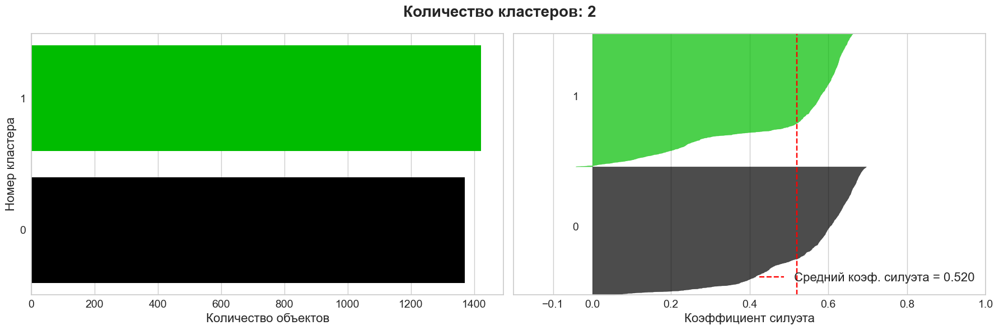

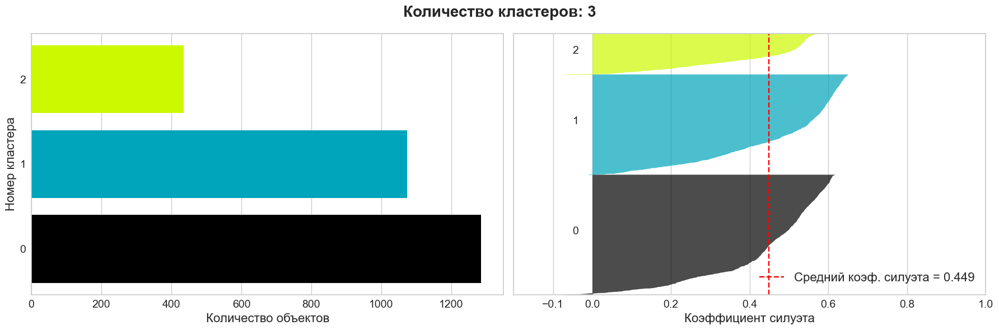

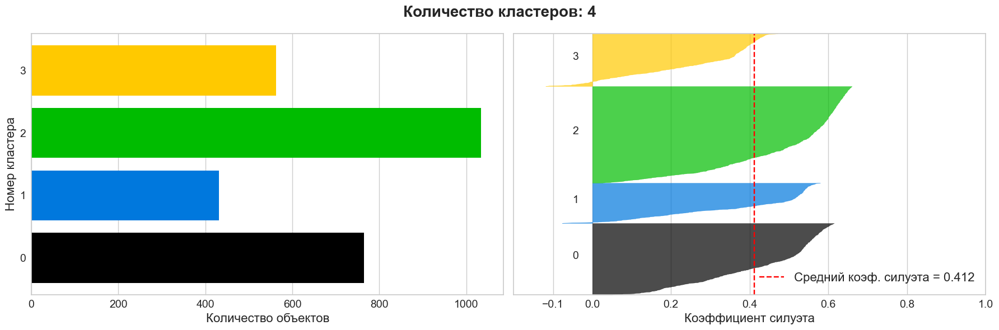

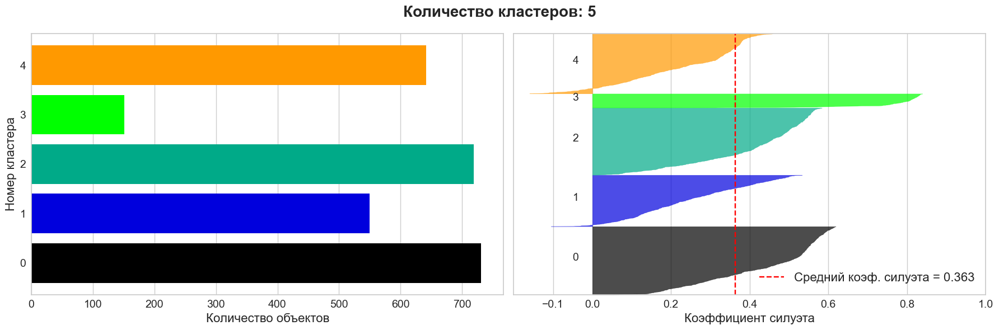

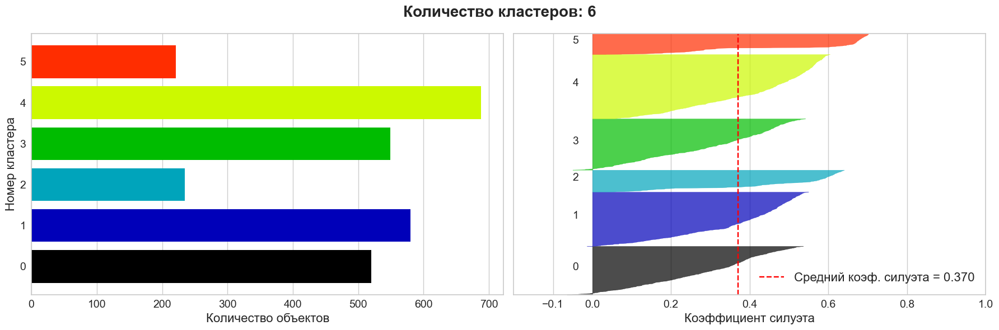

...

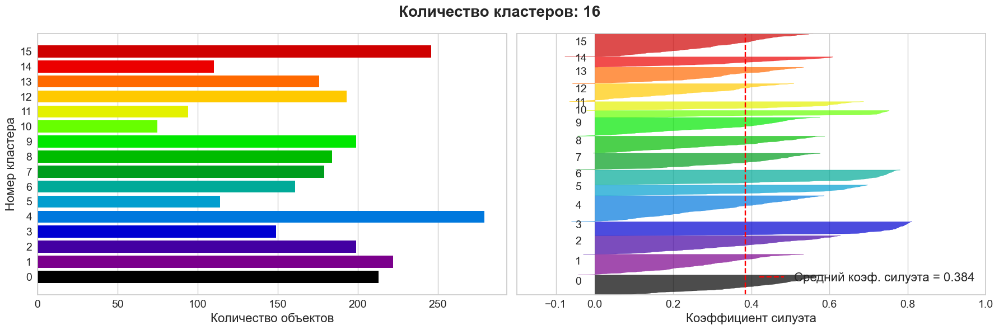

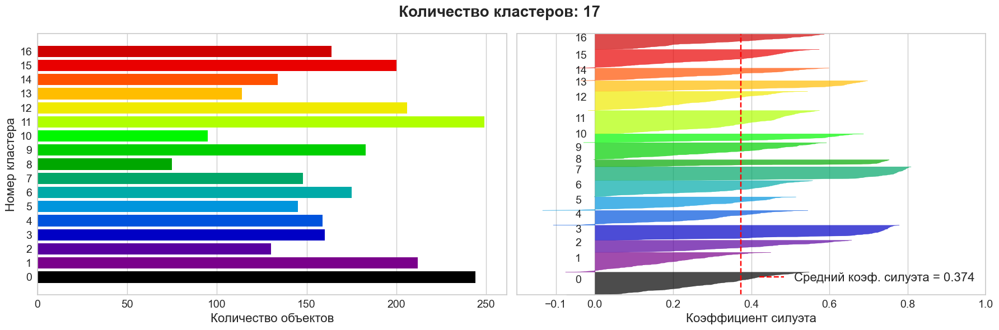

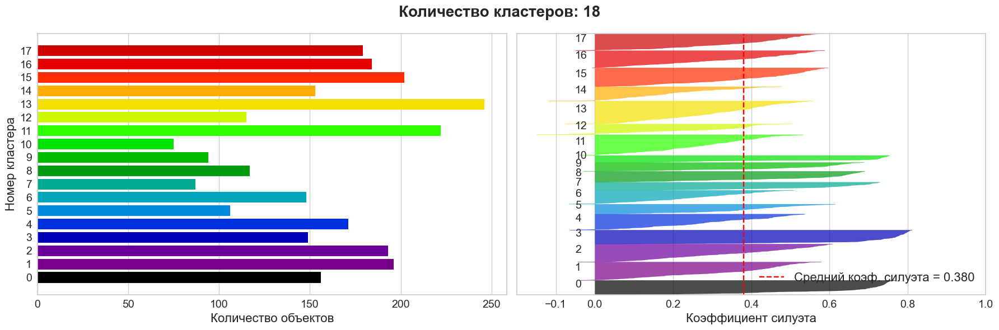

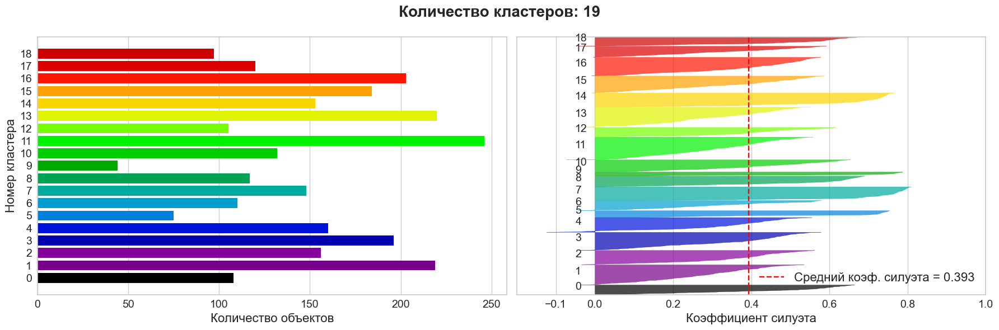

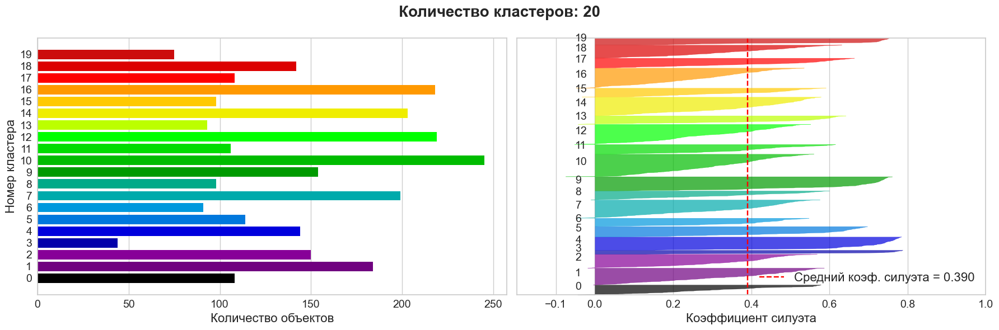

In [51]:
plot_silhouette(X_ft_umap, model=kmeans)

100%|██████████████████████████████████████████| 29/29 [01:11<00:00,  2.47s/it]


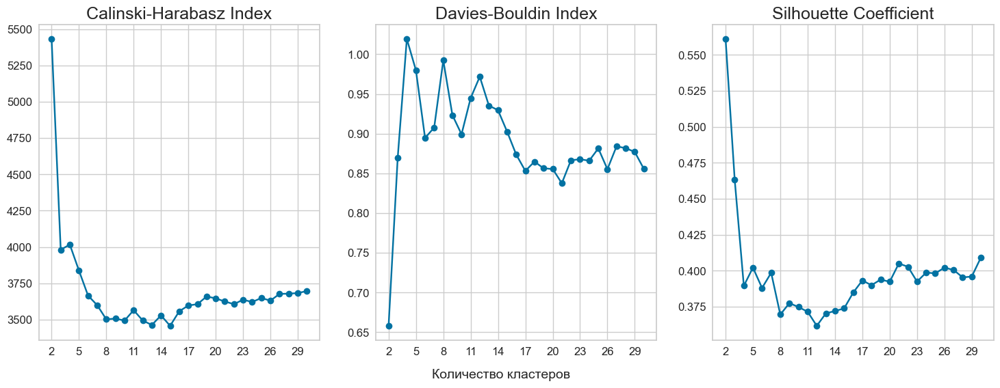

Лучшее количество кластеров: 2


In [49]:
best_cluster = cluster_metrics(X_ft_umap, model=kmeans, k=(2, 30))
print(f'Лучшее количество кластеров: {best_cluster}')

100%|██████████████████████████████████████████| 19/19 [00:38<00:00,  2.04s/it]


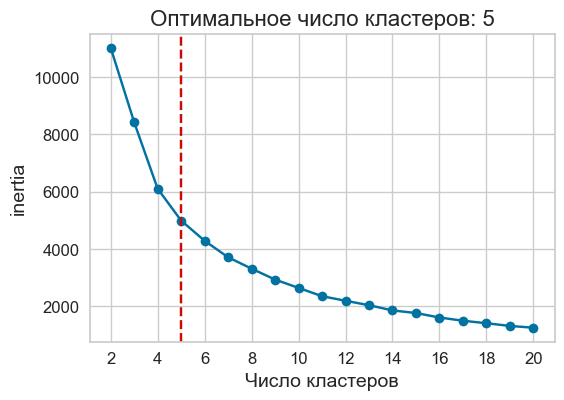

In [50]:
plot_elbow(X_ft_umap, model=kmeans)

In [51]:
kmeans = KMeans(n_clusters=best_cluster, **kmeans_params)
kmeans.fit(X_ft_umap)

df_clusters['KMeans'] = kmeans.labels_.astype(np.int8)

In [52]:
plot_3d(df_clusters, color='KMeans')

In [53]:
wordcloud = WordCloud(background_color='white', 
                      max_words=100, 
                      stopwords=diff, 
                      width=800, 
                      height=300, 
                      min_font_size=6, 
                      colormap='nipy_spectral',
                      random_state=RS)

Вордклауд создает словосочетания

In [54]:
wc_corpus = [' '.join(list_token) for list_token in filtered_tokenized_text]

CPU times: total: 3.98 s
Wall time: 4.33 s


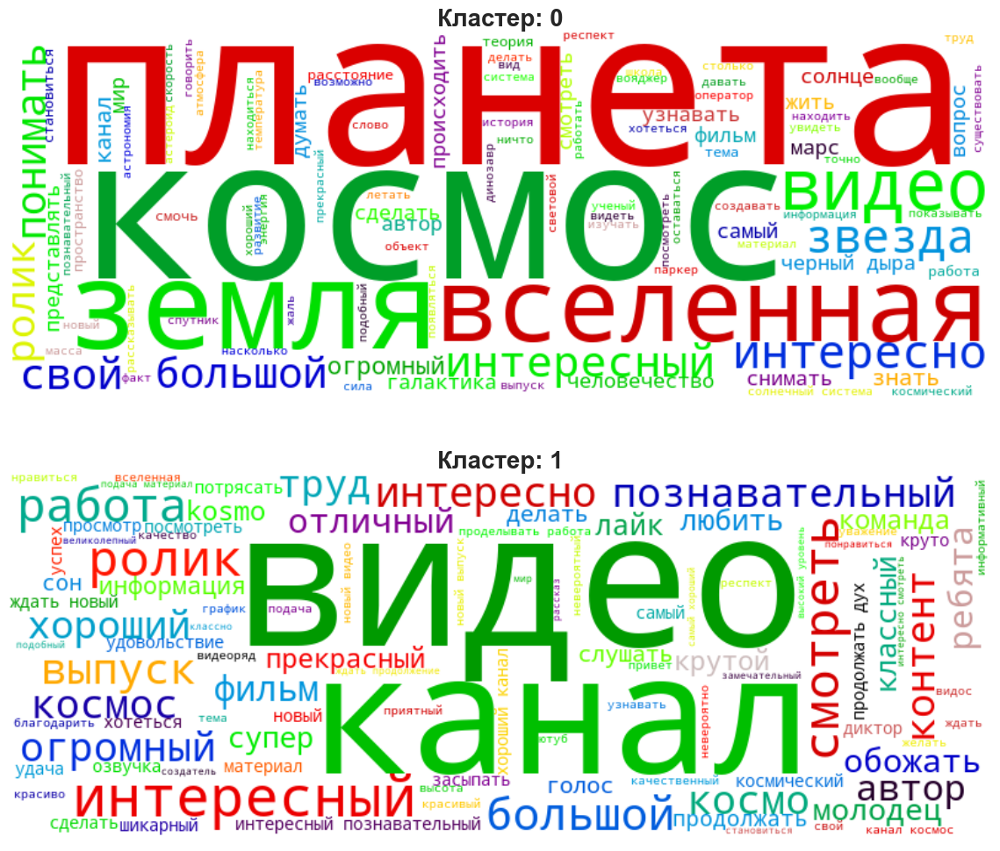

In [55]:
%%time
plot_wordcloud(wc_corpus, kmeans.labels_, wordcloud);

## Spectral Clustering

+ [towardsdatascience: Spectral Clustering](https://towardsdatascience.com/spectral-clustering-aba2640c0d5b)
+ [Getting Started with Spectral Clustering](https://juanitorduz.github.io/spectral_clustering/)


- хорошо работает для небольшого числа кластеров

In [56]:
spectr_params = {'affinity': 'nearest_neighbors',
                 'n_neighbors': 20,
                 'assign_labels': 'discretize',
                 'random_state': RS
                }

model_spectr = SpectralClustering(**spectr_params)

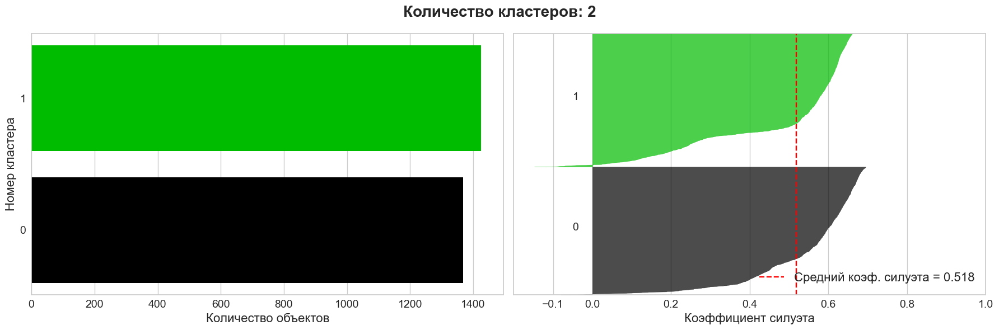

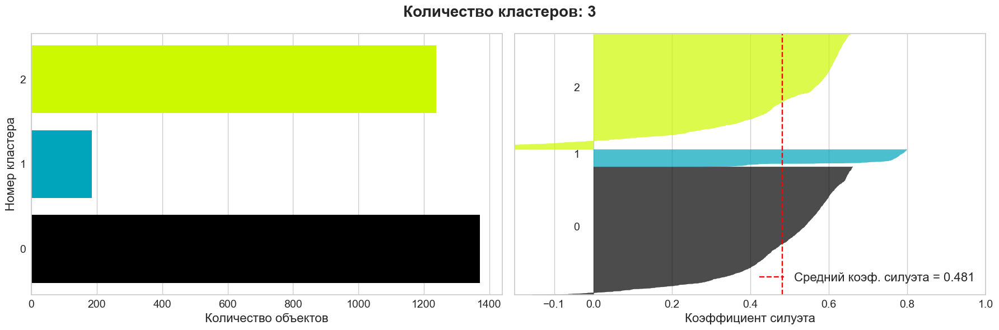

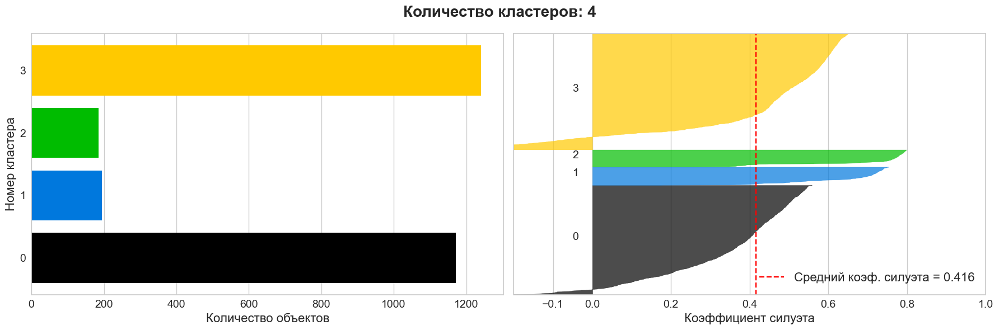

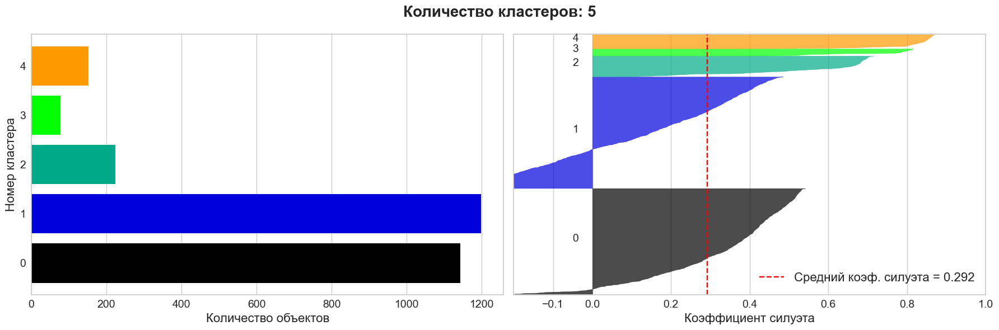

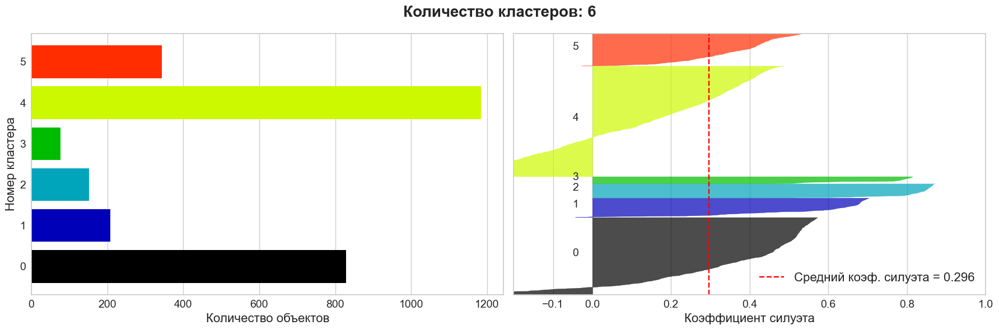

...

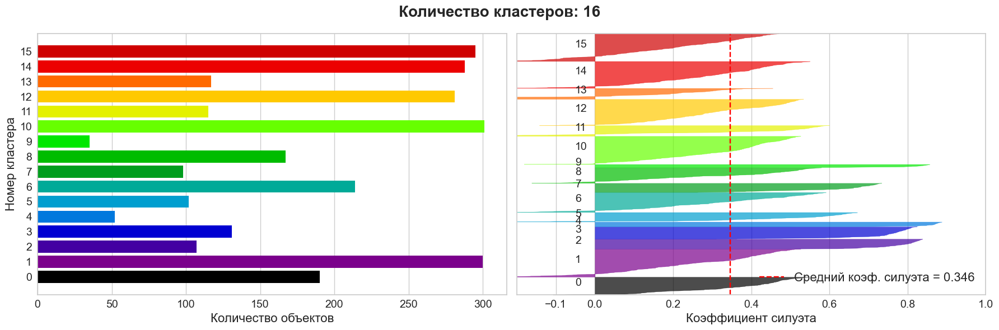

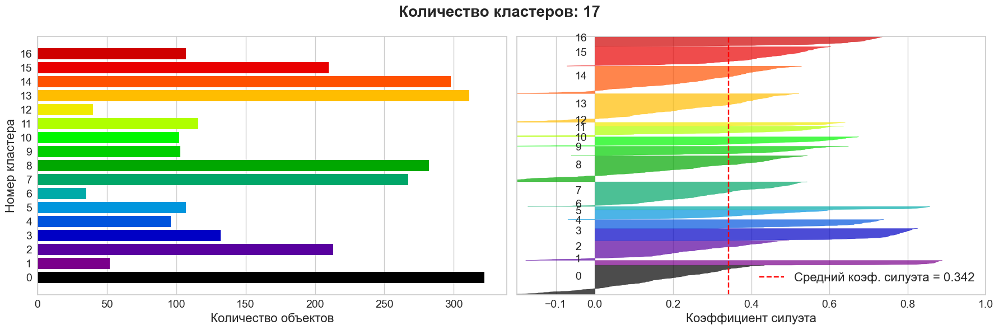

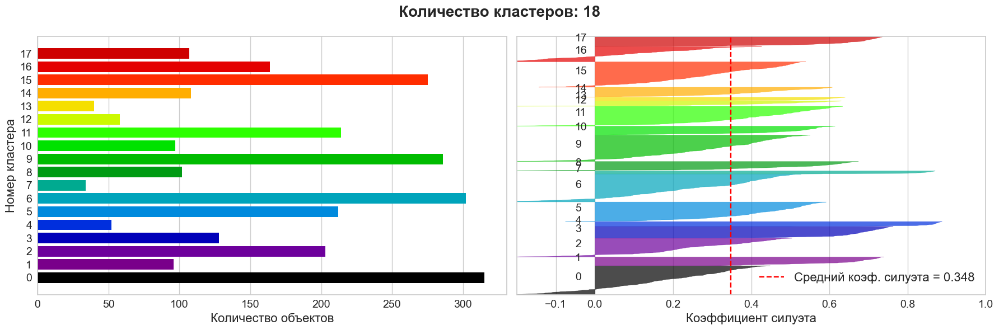

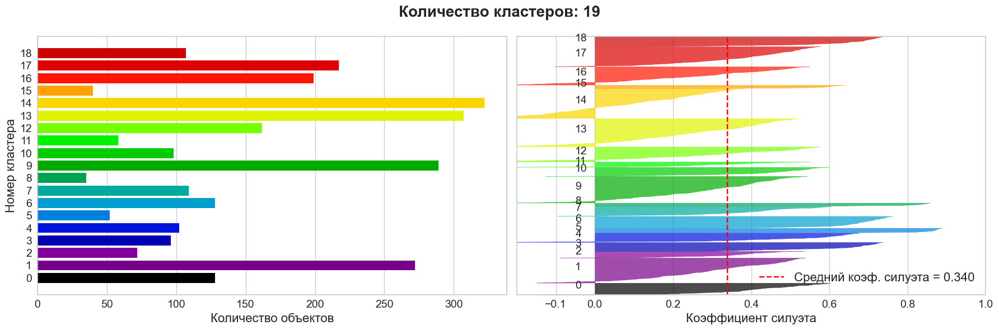

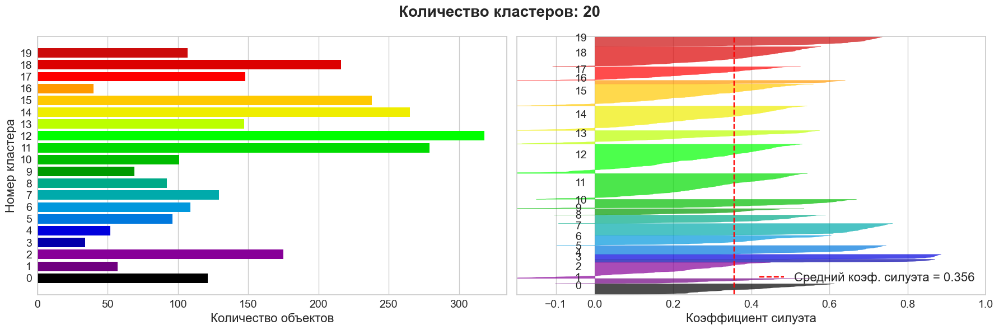

In [60]:
plot_silhouette(X_ft_umap, model=model_spectr)

100%|██████████████████████████████████████████| 29/29 [00:32<00:00,  1.13s/it]


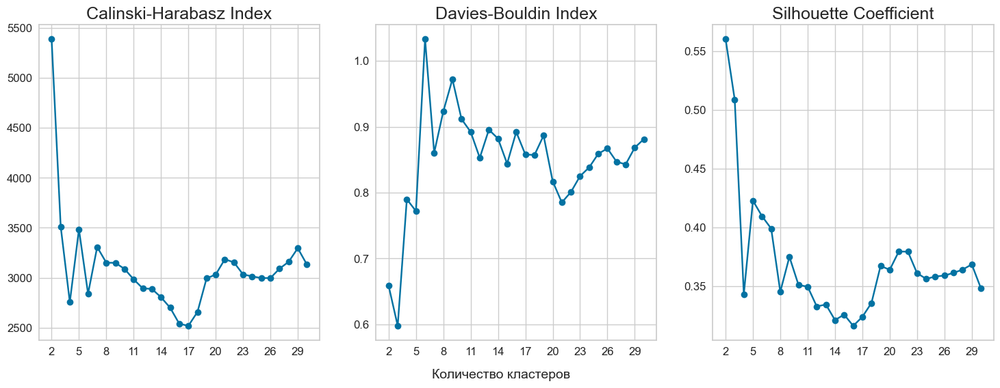

Лучшее количество кластеров: 2


In [57]:
best_cluster = cluster_metrics(X_ft_umap, model=model_spectr, k=(2, 30))
print(f'Лучшее количество кластеров: {best_cluster}')

In [58]:
model_spectr = SpectralClustering(n_clusters=best_cluster, **spectr_params)
model_spectr.fit(X_ft_umap)

df_clusters['SpectralClustering'] = model_spectr.labels_.astype(np.int8)

In [59]:
plot_3d(df_clusters, color='SpectralClustering')

CPU times: total: 4.11 s
Wall time: 4.15 s


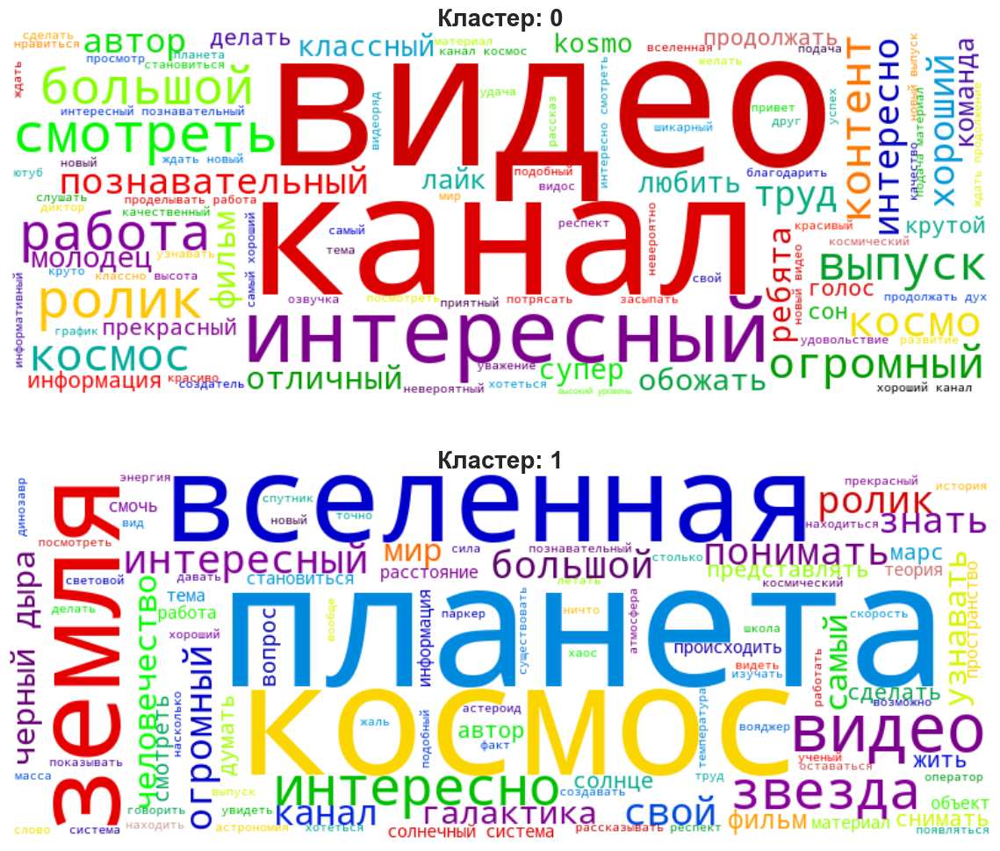

In [60]:
%%time
plot_wordcloud(wc_corpus, model_spectr.labels_, wordcloud);

## AgglomerativeClustering

**AgglomerativeClustering** выполняет иерархическую кластеризацию по принципу «снизу вверх»: каждое наблюдение начинается в своем собственном кластере, и кластеры последовательно объединяются.

[Изобразить дендограму](https://scikit-learn.org/stable/auto_examples/cluster/plot_agglomerative_dendrogram.html#sphx-glr-auto-examples-cluster-plot-agglomerative-dendrogram-py)

In [61]:
aglomerat_params = {'linkage': 'ward',
                   }
model_aglomerat = AgglomerativeClustering(**aglomerat_params)

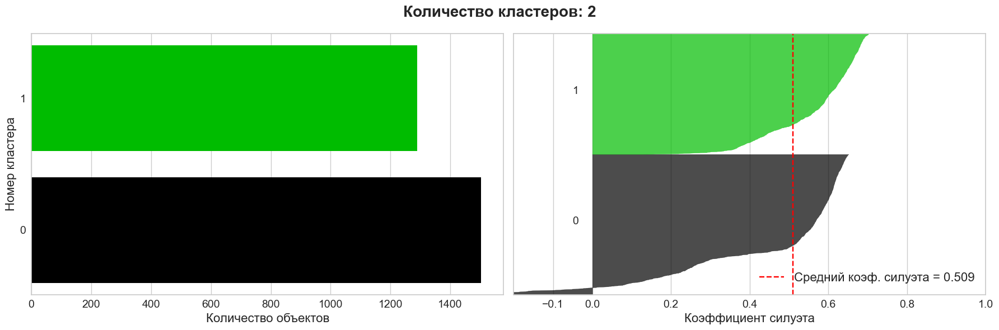

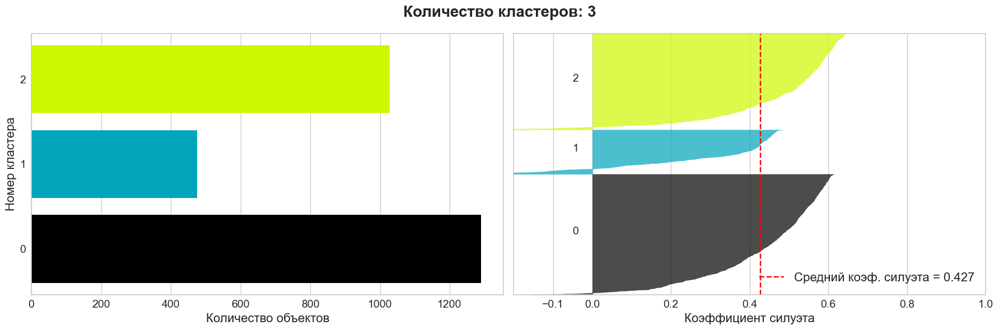

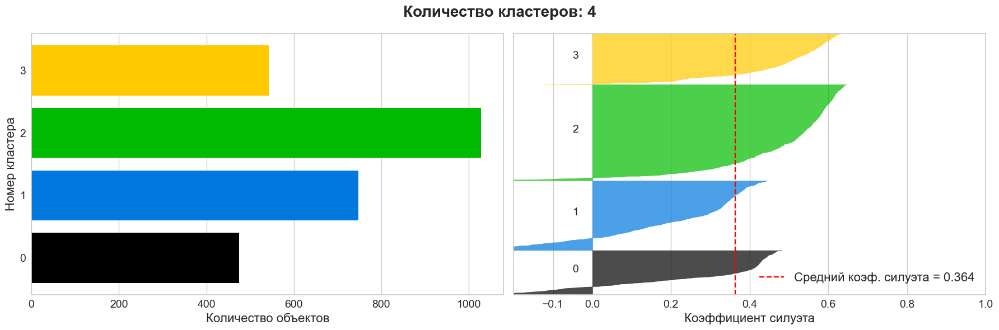

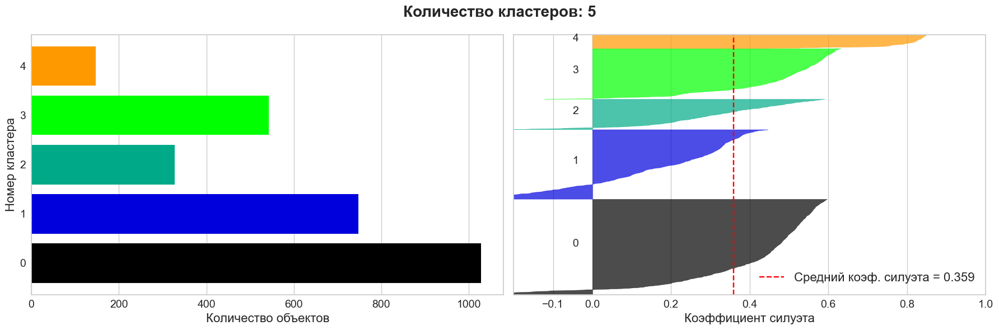

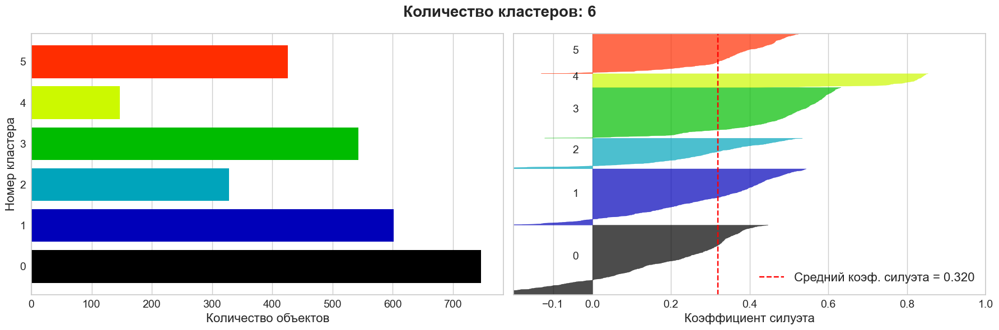

...

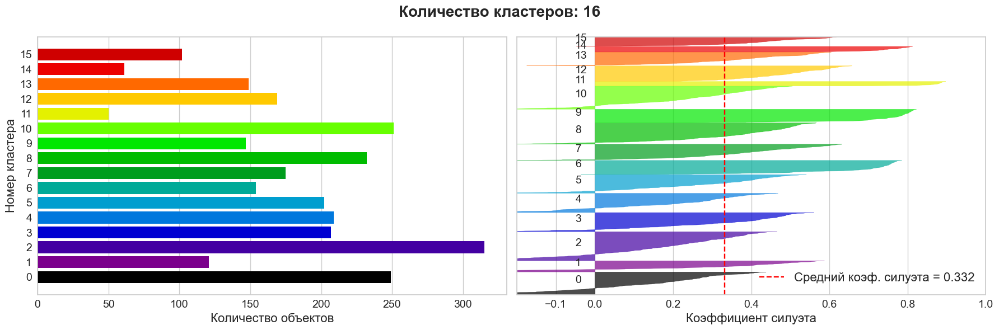

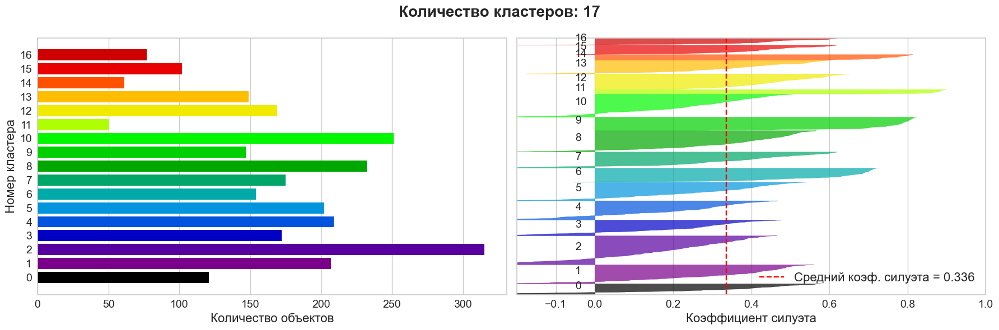

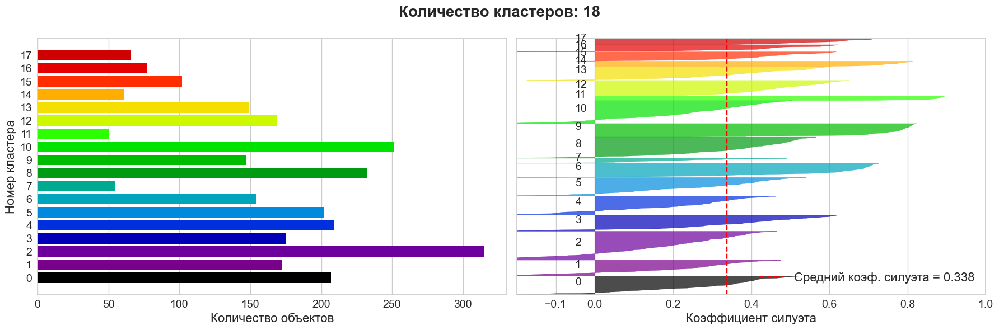

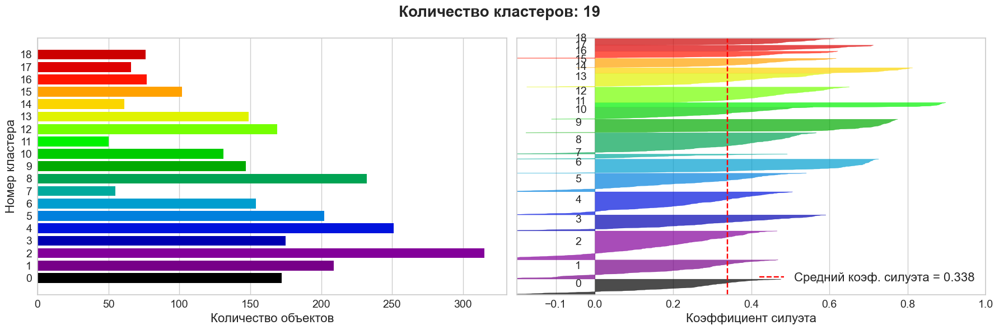

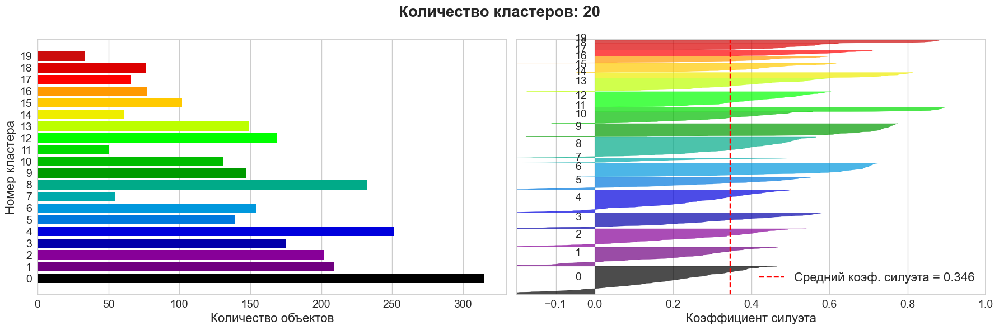

In [66]:
plot_silhouette(X_ft_umap, model=model_aglomerat)

100%|██████████████████████████████████████████| 19/19 [00:12<00:00,  1.56it/s]


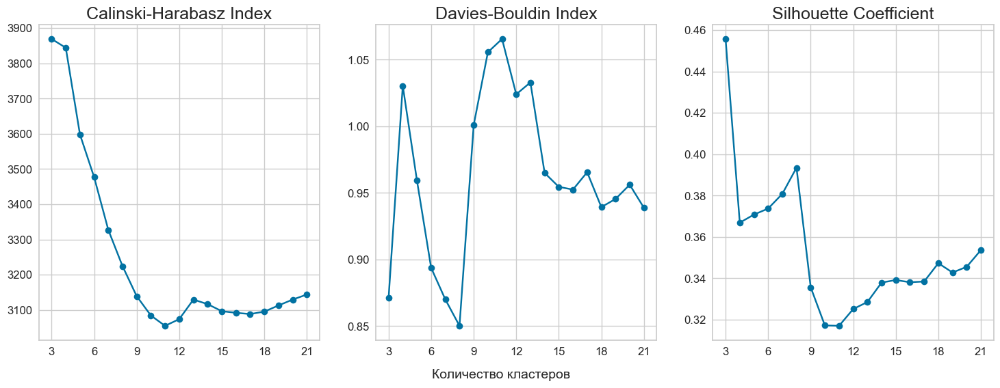

Лучшее количество кластеров: 3


In [62]:
best_cluster = cluster_metrics(X_ft_umap, model=model_aglomerat, k=(3, 21))
print(f'Лучшее количество кластеров: {best_cluster}')

In [63]:
# можно не указывать число кластеров
model_aglomerat = AgglomerativeClustering(n_clusters=None, 
                                          distance_threshold=25, 
                                          **aglomerat_params)
model_aglomerat.fit(X_ft_umap)

df_clusters['AgglomerativeClustering'] = model_aglomerat.labels_.astype(np.int8)

In [64]:
len(np.unique(model_aglomerat.labels_))

9

In [65]:
plot_3d(df_clusters, color='AgglomerativeClustering')

CPU times: total: 14.9 s
Wall time: 15 s


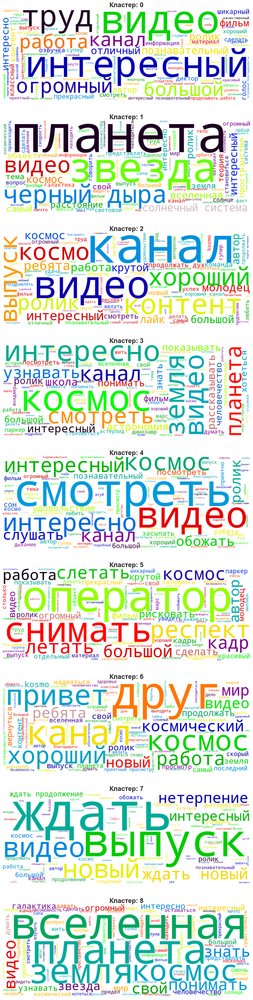

In [66]:
%%time
plot_wordcloud(wc_corpus, model_aglomerat.labels_, wordcloud);

## DBSCAN

**DBSCAN** рассматривает кластеры как области высокой плотности, разделенные областями низкой плотности

+ Более высокие значения `min_samples` или более низкие значения `eps` указывают на более высокую плотность, необходимую для формирования кластера
+ Объекты не отнесенные ни к одному кластеру помечаются как выбросы

In [67]:
dbscan_params = {'eps': 0.5, 'min_samples': 20}

model_dbscan = DBSCAN(**dbscan_params)
model_dbscan.fit(X_ft_umap)

df_clusters['DBSCAN'] = model_dbscan.labels_.astype(np.int8)

In [68]:
len(np.unique(model_dbscan.labels_))

8

In [69]:
plot_3d(df_clusters, color='DBSCAN')

CPU times: total: 12 s
Wall time: 12.6 s


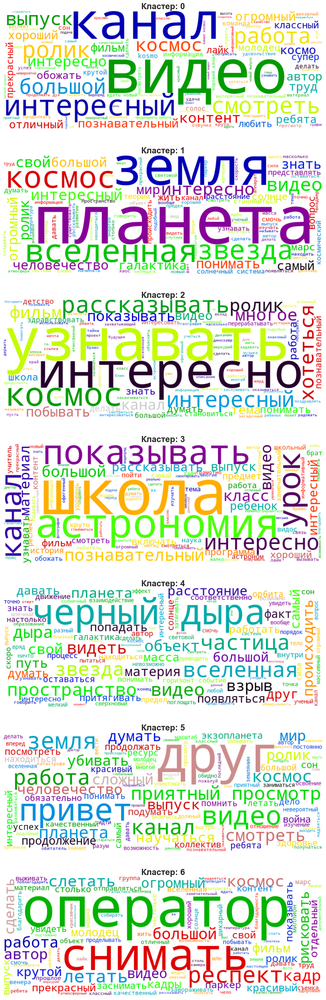

In [70]:
%%time
plot_wordcloud(wc_corpus, model_dbscan.labels_, wordcloud);

## HDBSCAN

+ `min_cluster_size` - минимальное количество объектов для образования кластера
+ `min_samples` - чем больше значение, тем более консервативна кластеризация — больше точек будет объявлено как шум, а кластеры будут ограничены все более плотными областями
+ `cluster_selection_epsilon` - гарантирует, что кластеры ниже заданного порога больше не будут разделены.

In [71]:
model_hdbscan = HDBSCAN(min_cluster_size=15, 
                        min_samples=10, 
                        metric='euclidean',
#                         cluster_selection_epsilon=0.1,
                       )
model_hdbscan.fit(X_ft_umap)

df_clusters['HDBSCAN'] = model_hdbscan.labels_.astype(np.int8)

In [72]:
len(np.unique(df_clusters['HDBSCAN']))

26

In [73]:
plot_3d(df_clusters, color='HDBSCAN')

CPU times: total: 41.7 s
Wall time: 42.2 s


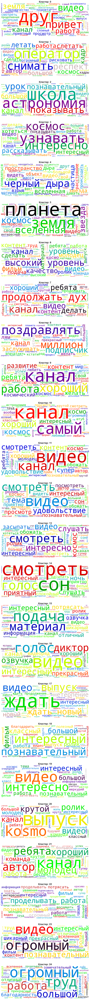

In [74]:
%%time
plot_wordcloud(wc_corpus, df_clusters['HDBSCAN'], wordcloud)

<AxesSubplot:ylabel='$\\lambda$ value'>

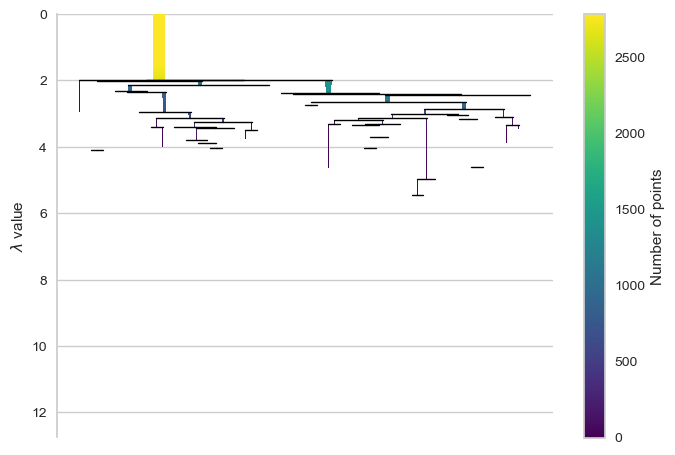

In [75]:
model_hdbscan.condensed_tree_.plot()

### Цветовая карта

In [107]:
algorithm = 'DBSCAN'
uniq_clusters = np.unique(df_clusters[algorithm])
color_map = get_color_map(uniq_clusters, px.colors.qualitative.Dark24)
color_map[NOISE_NAME] = NOISE_COLOR

In [109]:
# Считаем количество комментариев в каждом кластере
df_pie = df_clusters[algorithm].value_counts().reset_index()
# Меняем имя кластера шума
df_pie['index'] = df_pie['index'].where(df_pie['index'] != NOISE, NOISE_NAME)
# приводим к строковому типу для идентификации с color_discrete_map
df_pie['index'] = df_pie['index'].astype('str')
fig = px.pie(df_pie, 
             values=algorithm,
             color='index',
             names='index',
             hole=0.4,
             labels={'index': 'Кластер', algorithm: 'Размер'},
#              color_discrete_sequence=px.colors.qualitative.Dark24,
             color_discrete_map=color_map
            )
# fig.update_layout(title_text='Размер кластеров', title_x=0.5)
fig.update_layout(legend=dict(
    orientation="v", 
    yanchor="top",
    y=1,
    xanchor="right",
    x=1,
    title_text='Кластеры:',
))

fig.show()

In [78]:
plot_3d(df_clusters, color=algorithm, color_discrete_map=color_map)

### Память

In [80]:
import sys

Не ожидается что кластеров будет больше 127, поэтому испозуется тип np.int8

In [81]:
np.array(128, dtype=np.int8)

array(-128, dtype=int8)

In [82]:
df_clusters.head()

,x,y,z,KMeans,SpectralClustering,AgglomerativeClustering,DBSCAN,HDBSCAN
0,3.572266,-0.507812,1.724609,1,0,2,0,-1
1,4.734375,1.857422,3.833984,1,0,4,0,-1
2,2.265625,1.146484,3.564453,1,0,0,0,-1
3,10.859375,-0.369629,0.723633,0,1,1,1,5
4,9.109375,0.923828,2.333984,0,1,8,1,-1


In [83]:
df_clusters.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2784 entries, 0 to 2783
Data columns (total 8 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   x                        2784 non-null   float16
 1   y                        2784 non-null   float16
 2   z                        2784 non-null   float16
 3   KMeans                   2784 non-null   int8   
 4   SpectralClustering       2784 non-null   int8   
 5   AgglomerativeClustering  2784 non-null   int8   
 6   DBSCAN                   2784 non-null   int8   
 7   HDBSCAN                  2784 non-null   int8   
dtypes: float16(3), int8(5)
memory usage: 30.0 KB


In [84]:
df_clusters.dtypes

x                          float16
y                          float16
z                          float16
KMeans                        int8
SpectralClustering            int8
AgglomerativeClustering       int8
DBSCAN                        int8
HDBSCAN                       int8
dtype: object

In [85]:
print('Кбайт:', round(df_clusters.memory_usage().sum() / 1024, 3))

Кбайт: 30.031


In [86]:
# Не учитываются индексы DataFrame
floats = df_clusters.iloc[:, :3].values.nbytes / 1024
ints = df_clusters.iloc[:, 3:].values.nbytes / 1024
print('Кбайт:', round(floats + ints, 3))

Кбайт: 29.906


#### Текст

In [90]:
sys.getsizeof(filtered_tokenized_text) 
print('Кбайт:', round(sys.getsizeof(filtered_tokenized_text) / 1024, 3))

Кбайт: 21.953


In [91]:
print('Кбайт:', round(np.array(filtered_tokenized_text, dtype=object).nbytes / 1024, 3))

Кбайт: 21.75


In [92]:
df_text = pd.DataFrame({'filtered_tokenized_text': filtered_tokenized_text})
df_text.head()

,filtered_tokenized_text
0,"[ура, ура, новый, полнометражка, труд]"
1,"[чудесный, видео, смотреть, удовольствие]"
2,"[интересный, видео, проделывать, работа]"
3,"[интересный, планета, земля, оставаться, жемчу..."
4,"[поражать, глубина, душа, удивительно, страшно..."


In [93]:
print('КБайт:', df_text.memory_usage().sum() / 1024)

КБайт: 21.875


TODO:
+ fastapi
+ 4-5 мерную визуализация
+ вычленять имена
+ сентимент анализ
+ BERT